In [ ]:
# Install KaggleHub
!pip install kagglehub
import kagglehub
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

# Download datasets
paris_path = kagglehub.dataset_download("piterfm/paris-2024-olympic-summer-games")
tokyo_path = kagglehub.dataset_download("piterfm/tokyo-2020-olympics")

print("Path to Paris dataset files:", paris_path)
print("Path to Tokyo dataset files:", tokyo_path)

# Load datasets
paris_athletes = pd.read_csv(f"{paris_path}/athletes.csv")
tokyo_athletes = pd.read_csv(f"{tokyo_path}/athletes.csv")

100%|██████████| 2.95M/2.95M [00:00<00:00, 105MB/s]

Extracting files...


100%|██████████| 670k/670k [00:00<00:00, 84.7MB/s]

Extracting files...
Path to Paris dataset files: /root/.cache/kagglehub/datasets/piterfm/paris-2024-olympic-summer-games/versions/27
Path to Tokyo dataset files: /root/.cache/kagglehub/datasets/piterfm/tokyo-2020-olympics/versions/2


In [ ]:
# Load the dataset (assuming it has been downloaded via KaggleHub)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

paris_athletes = pd.read_csv(f"{paris_path}/athletes.csv")

# Quick look at the dataset
print(paris_athletes.head())


      code  current               name     name_short            name_tv  \
0  1532872     True   ALEKSANYAN Artur   ALEKSANYAN A   Artur ALEKSANYAN   
1  1532873     True     AMOYAN Malkhas       AMOYAN M     Malkhas AMOYAN   
2  1532874     True    GALSTYAN Slavik     GALSTYAN S    Slavik GALSTYAN   
3  1532944     True  HARUTYUNYAN Arsen  HARUTYUNYAN A  Arsen HARUTYUNYAN   
4  1532945     True    TEVANYAN Vazgen     TEVANYAN V    Vazgen TEVANYAN   

  gender function country_code  country country_long  ...  \
0   Male  Athlete          ARM  Armenia      Armenia  ...   
1   Male  Athlete          ARM  Armenia      Armenia  ...   
2   Male  Athlete          ARM  Armenia      Armenia  ...   
3   Male  Athlete          ARM  Armenia      Armenia  ...   
4   Male  Athlete          ARM  Armenia      Armenia  ...   

                                              family  \
0                          Father, Gevorg Aleksanyan   
1                                                NaN   
2       

Player with the most personal coaches:
            name nationality                           coach
5  ARENAS Lorena    Colombia  Personal: Brent Vallance (AUS)

Player with the most national coaches:
                name nationality                          coach
3  HARUTYUNYAN Arsen     Armenia  National: Habetnak Kurghinyan

Medals won by ARENAS Lorena (Colombia):
Empty DataFrame
Columns: [medal_type, discipline, event]
Index: []

Medals won by HARUTYUNYAN Arsen (Armenia):
Empty DataFrame
Columns: [medal_type, discipline, event]
Index: []

ARENAS Lorena has won 0 medals.
HARUTYUNYAN Arsen has won 0 medals.

Players with the most coaches and their medals:
                           name nationality  coach_count  medal_count
1109              MICHELI Elena       Italy           14          0.0
8033                 WEARN Matt   Australia           13          0.0
8034                JERWOOD Nia   Australia           12          0.0
8029             NICHOLAS Conor   Australia           

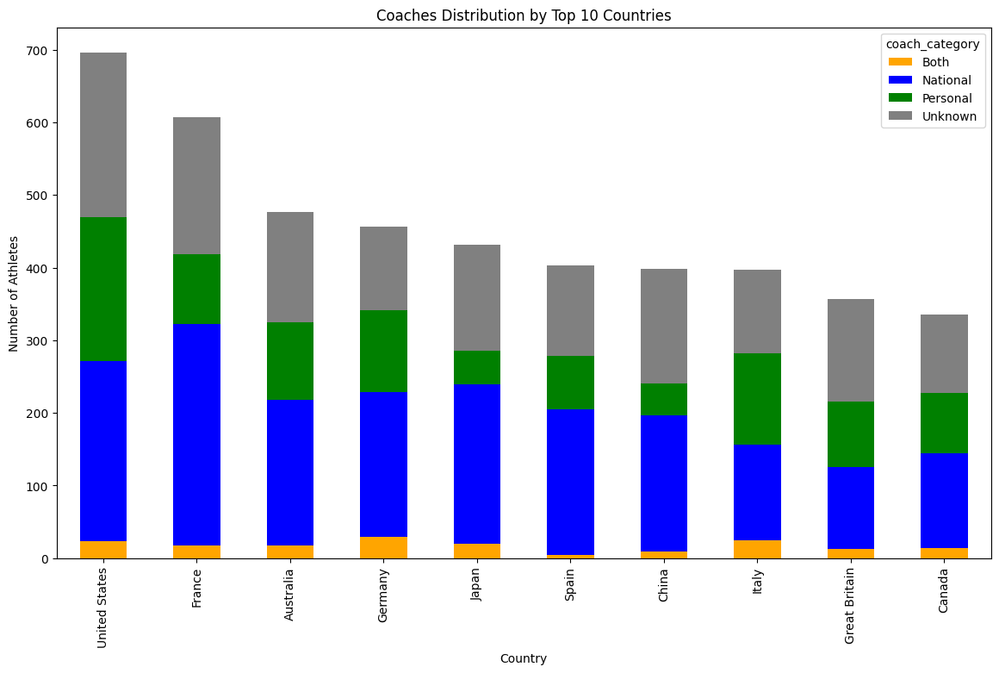

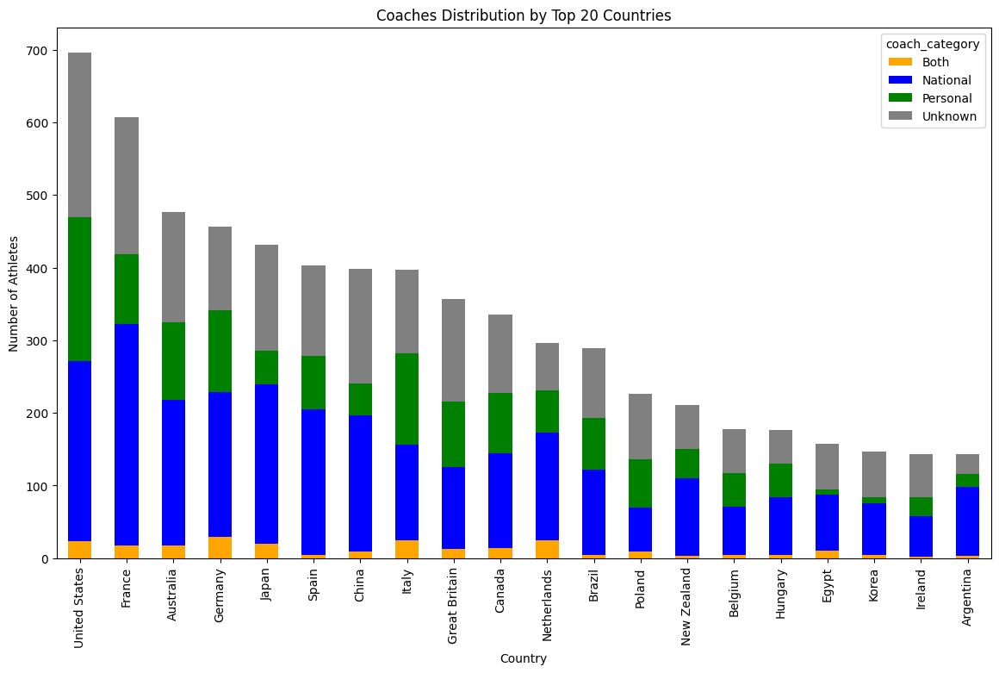

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Categorize coaches as Personal, National, Both, or Unknown
def categorize_coaches(coach_column):
    if pd.isna(coach_column):
        return "Unknown"
    elif "personal" in coach_column.lower() and "national" in coach_column.lower():
        return "Both"
    elif "personal" in coach_column.lower():
        return "Personal"
    elif "national" in coach_column.lower():
        return "National"
    else:
        return "Unknown"

# Apply the function to create a new column
paris_athletes['coach_category'] = paris_athletes['coach'].apply(categorize_coaches)

# Count athletes by coach category and country
country_coaches = paris_athletes.groupby(['nationality', 'coach_category']).size().unstack(fill_value=0)

# Add a total column for sorting
country_coaches['Total'] = country_coaches.sum(axis=1)

# Top 10 and Top 20 Countries
top_10_countries = country_coaches.sort_values(by='Total', ascending=False).head(10)
top_20_countries = country_coaches.sort_values(by='Total', ascending=False).head(20)

# Drop the 'Total' column for plotting
top_10_countries_for_plot = top_10_countries.drop(columns=['Total'])
top_20_countries_for_plot = top_20_countries.drop(columns=['Total'])

# Player with the most Personal and National coaches
player_personal = paris_athletes[paris_athletes['coach_category'] == "Personal"]['name'].value_counts().idxmax()
player_national = paris_athletes[paris_athletes['coach_category'] == "National"]['name'].value_counts().idxmax()

# Fetch full details for these players
player_personal_details = paris_athletes[paris_athletes['name'] == player_personal]
player_national_details = paris_athletes[paris_athletes['name'] == player_national]

# Print details of the players
print("Player with the most personal coaches:")
print(player_personal_details[['name', 'nationality', 'coach']])

print("\nPlayer with the most national coaches:")
print(player_national_details[['name', 'nationality', 'coach']])

# Number of medals won
medals = pd.read_csv(f"{paris_path}/medals.csv")  # Load medals dataset
medals_personal = medals[medals['name'] == player_personal]
medals_national = medals[medals['name'] == player_national]

print(f"\nMedals won by {player_personal} ({player_personal_details['nationality'].iloc[0]}):")
print(medals_personal[['medal_type', 'discipline', 'event']])

print(f"\nMedals won by {player_national} ({player_national_details['nationality'].iloc[0]}):")
print(medals_national[['medal_type', 'discipline', 'event']])

# Total medal counts
total_medals_personal = len(medals_personal)
total_medals_national = len(medals_national)

print(f"\n{player_personal} has won {total_medals_personal} medals.")
print(f"{player_national} has won {total_medals_national} medals.")

# Check if players with more coaches have won medals
paris_athletes['coach_count'] = paris_athletes['coach'].apply(lambda x: len(str(x).split(',')) if pd.notna(x) else 0)

# Merge athletes with their medal count
athlete_medal_count = medals.groupby('name').size().reset_index(name='medal_count')
paris_athletes_with_medals = paris_athletes.merge(athlete_medal_count, how='left', left_on='name', right_on='name')
paris_athletes_with_medals['medal_count'] = paris_athletes_with_medals['medal_count'].fillna(0)

# Players with highest number of coaches and their medal status
players_most_coaches = paris_athletes_with_medals.sort_values(by='coach_count', ascending=False).head(10)
print("\nPlayers with the most coaches and their medals:")
print(players_most_coaches[['name', 'nationality', 'coach_count', 'medal_count']])

# Plot Top 10 Countries
top_10_countries_for_plot.plot(kind='bar', stacked=True, figsize=(14, 8), color=['orange', 'blue', 'green', 'gray'])
plt.title("Coaches Distribution by Top 10 Countries")
plt.ylabel("Number of Athletes")
plt.xlabel("Country")
plt.show()

# Plot Top 20 Countries
top_20_countries_for_plot.plot(kind='bar', stacked=True, figsize=(14, 8), color=['orange', 'blue', 'green', 'gray'])
plt.title("Coaches Distribution by Top 20 Countries")
plt.ylabel("Number of Athletes")
plt.xlabel("Country")
plt.show()

# Interactive Plot: Number of Coaches vs Medal Count
fig = px.scatter(
    paris_athletes_with_medals,
    x='coach_count',
    y='medal_count',
    color='gender',
    hover_data=['name', 'nationality', 'disciplines', 'events'],
    title="Number of Coaches vs Medal Count",
    labels={'coach_count': 'Number of Coaches', 'medal_count': 'Number of Medals'},
    size='medal_count'
)

fig.show()


Summary of athletes' disciplines and events:
       num_disciplines    num_events
count     11113.000000  11113.000000
mean          1.001620      1.001800
std           0.040215      0.042387
min           1.000000      1.000000
25%           1.000000      1.000000
50%           1.000000      1.000000
75%           1.000000      1.000000
max           2.000000      2.000000
Number of athletes in multiple disciplines: 18
Number of athletes in multiple events: 20

Top countries with athletes participating in multiple disciplines and events:
     nationality  num_athletes_multi_discipline  num_athletes_multi_event  \
2          China                            4.0                         4   
3          Egypt                            4.0                         4   
1      Australia                            2.0                         2   
4          Japan                            2.0                         2   
7       Slovenia                            2.0                      

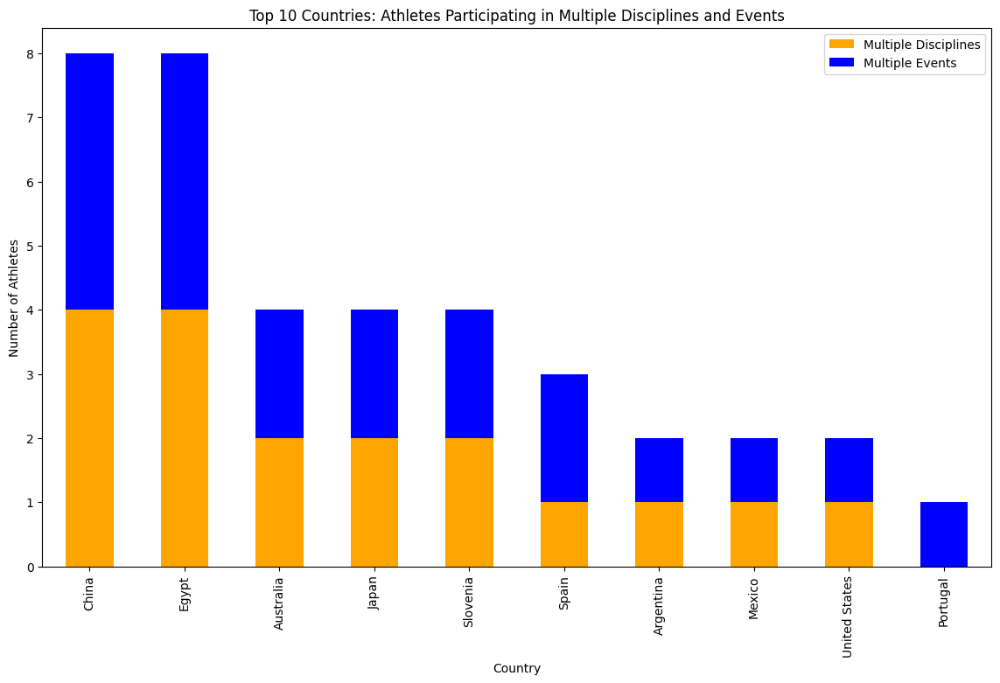

Filtered athletes for scatter plot (multiple disciplines or events):
                     name    nationality  num_disciplines  num_events
56     FERNANDEZ Federico         Mexico                2           2
398    FERNANDEZ Federico      Argentina                2           2
503         WATANABE Yuta          Japan                2           2
894           PEREZ Maria  United States                2           2
1553      ELSAYED Mohamed          Egypt                2           2
1691          HAMZA Malak          Egypt                2           2
4130        WATANABE Yuta          Japan                2           2
4518          PEREZ Maria          Spain                2           2
5602              SUN Yue          China                2           2
6293             YANG Liu          China                2           2
6310             YANG Liu          China                2           2
6361              SUN Yue          China                2           2
7070      ELSAYED Moh

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

# Count unique disciplines and events for each athlete
paris_athletes['num_disciplines'] = paris_athletes.groupby('name')['disciplines'].transform('nunique')
paris_athletes['num_events'] = paris_athletes.groupby('name')['events'].transform('nunique')

# Filter athletes participating in multiple disciplines or events
multi_discipline_athletes = paris_athletes[paris_athletes['num_disciplines'] > 1]
multi_event_athletes = paris_athletes[paris_athletes['num_events'] > 1]

# Debugging: Check the summary of disciplines and events
print("Summary of athletes' disciplines and events:")
print(paris_athletes[['num_disciplines', 'num_events']].describe())

# Check how many athletes qualify for the scatter plot
print(f"Number of athletes in multiple disciplines: {len(multi_discipline_athletes)}")
print(f"Number of athletes in multiple events: {len(multi_event_athletes)}")

# Country-level analysis for bar chart
multi_discipline_by_country = multi_discipline_athletes.groupby('nationality').size().reset_index(name='num_athletes_multi_discipline')
multi_event_by_country = multi_event_athletes.groupby('nationality').size().reset_index(name='num_athletes_multi_event')

# Merge results
multi_analysis = pd.merge(
    multi_discipline_by_country,
    multi_event_by_country,
    on='nationality',
    how='outer'
).fillna(0)

# Total athletes by country
multi_analysis['total'] = multi_analysis['num_athletes_multi_discipline'] + multi_analysis['num_athletes_multi_event']

# Sort and display top 10 countries
multi_analysis = multi_analysis.sort_values(by='total', ascending=False)
print("\nTop countries with athletes participating in multiple disciplines and events:")
print(multi_analysis.head(10))

# Visualization 1: Stacked Bar Chart for Top 10 Countries
multi_analysis_top = multi_analysis.head(10)
multi_analysis_top.set_index('nationality')[['num_athletes_multi_discipline', 'num_athletes_multi_event']].plot(
    kind='bar', stacked=True, figsize=(14, 8), color=['orange', 'blue']
)
plt.title("Top 10 Countries: Athletes Participating in Multiple Disciplines and Events")
plt.ylabel("Number of Athletes")
plt.xlabel("Country")
plt.legend(["Multiple Disciplines", "Multiple Events"])
plt.show()

# Prepare data for scatter plot (individual athletes)
multi_athletes = paris_athletes[
    (paris_athletes['num_disciplines'] > 1) | (paris_athletes['num_events'] > 1)
]

# Debugging: Check filtered data for scatter plot
print("Filtered athletes for scatter plot (multiple disciplines or events):")
print(multi_athletes[['name', 'nationality', 'num_disciplines', 'num_events']].head(20))
print(f"Number of athletes in filtered data: {len(multi_athletes)}")

# Use the filtered data directly for the scatter plot
fig = px.scatter(
    multi_athletes,
    x='num_disciplines',
    y='num_events',
    size='num_disciplines',
    color='nationality',
    hover_name='name',
    hover_data={
        'nationality': True,
        'num_disciplines': True,
        'num_events': True
    },
    title="Athletes Participating in Multiple Disciplines and Events",
    labels={
        'num_disciplines': 'Number of Disciplines',
        'num_events': 'Number of Events'
    }
)

fig.update_traces(marker=dict(opacity=0.8))
fig.show()


In [ ]:
import pandas as pd
import plotly.express as px

# Exclude missing values in the occupation column
valid_occupation_athletes = paris_athletes[paris_athletes['occupation'].notna()]

# Group by country and occupation to count athletes
occupation_count_by_country = valid_occupation_athletes.groupby(['nationality', 'occupation']).size().reset_index(name='count')

# Find the major occupation for each country
major_occupation_by_country = occupation_count_by_country.loc[occupation_count_by_country.groupby('nationality')['count'].idxmax()]

# Sort the results by the number of athletes in descending order
major_occupation_by_country = major_occupation_by_country.sort_values(by='count', ascending=False)

# Interactive Bar Chart: Major Occupation by Country
fig = px.bar(
    major_occupation_by_country,
    x='nationality',
    y='count',
    color='occupation',
    title="Major Occupation of Athletes by Country (Interactive)",
    labels={'count': 'Number of Athletes', 'nationality': 'Country', 'occupation': 'Occupation'},
    hover_data=['occupation']
)
fig.update_layout(
    xaxis={'categoryorder': 'total descending'},
    height=600,  # Adjust height for better readability
    width=1000   # Adjust width for better readability
)
fig.show()

# Enhanced Sunburst Chart for Occupation Breakdown
# Filter out rows with missing values in any of the path columns
sunburst_data = valid_occupation_athletes.dropna(subset=['nationality', 'occupation', 'name'])

fig_table = px.sunburst(
    sunburst_data,  # Use the filtered data
    path=['nationality', 'occupation', 'name'],  # Path: Country -> Occupation -> Athlete Name
    title="Detailed Breakdown of Athletes' Occupations by Country",
    color='nationality',  # Use nationality to color the chart
    hover_data={'occupation': True, 'name': True},  # Add detailed hover data
)

# Increase the size of the sunburst chart
fig_table.update_layout(
    height=1000,  # Increased height
    width=1000,   # Increased width
    margin=dict(t=50, l=50, r=50, b=50),  # Adjust margins
    title_font_size=20  # Larger title font size for better visibility
)

# Show the chart
fig_table.show()


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


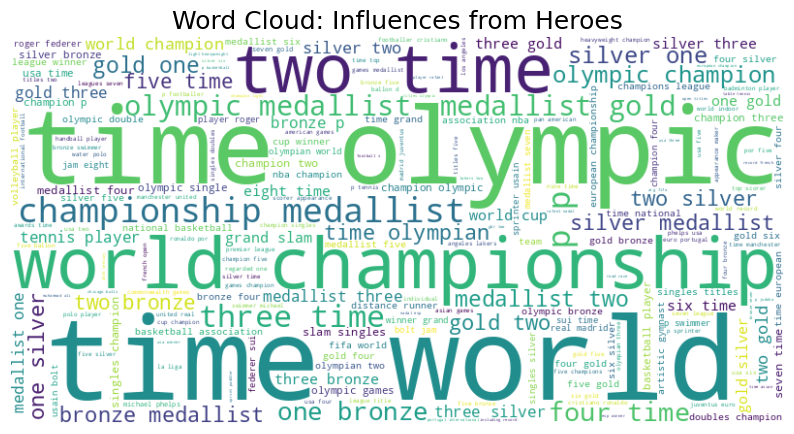

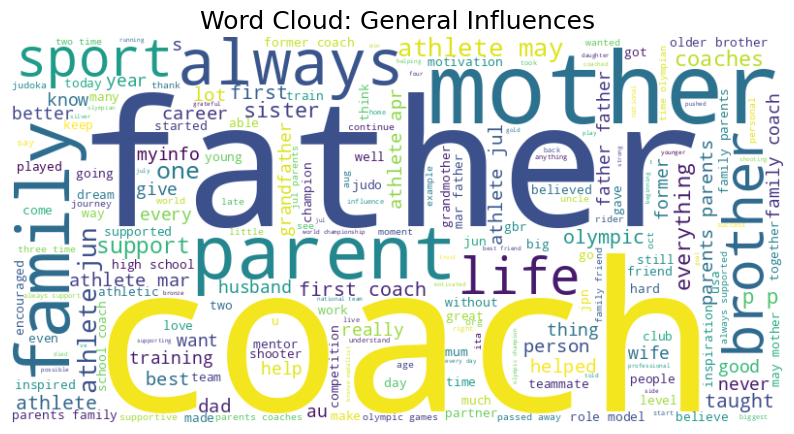

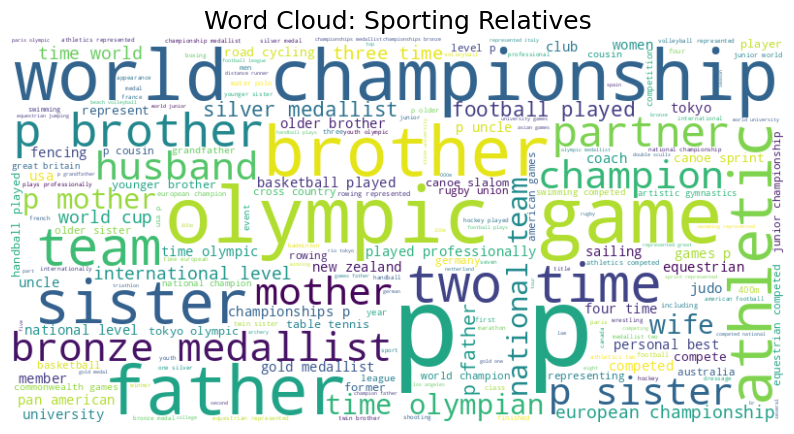

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter
import plotly.express as px
import nltk
from nltk.corpus import stopwords

# Download NLTK stopwords
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

# Custom preprocessing function to clean text
def preprocess_text(df, column):
    text_data = df[column].dropna()  # Drop null values
    combined_text = " ".join(text_data)  # Combine all text into a single string
    # Tokenize and filter stop words
    words = [word.lower() for word in combined_text.split() if word.lower() not in stop_words]
    return " ".join(words)

# Preprocess the text columns
hero_text = preprocess_text(paris_athletes, 'hero')
influence_text = preprocess_text(paris_athletes, 'influence')
sporting_relatives_text = preprocess_text(paris_athletes, 'sporting_relatives')

# Generate Word Clouds
def generate_wordcloud(text, title):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title, fontsize=18)
    plt.show()

# Word Cloud for 'Hero'
generate_wordcloud(hero_text, "Word Cloud: Influences from Heroes")

# Word Cloud for 'Influence'
generate_wordcloud(influence_text, "Word Cloud: General Influences")

# Word Cloud for 'Sporting Relatives'
generate_wordcloud(sporting_relatives_text, "Word Cloud: Sporting Relatives")

# Analyze Keyword Frequency
def get_keyword_counts(text):
    words = text.split()
    word_counts = Counter(words)
    return word_counts.most_common(10)

# Top keywords in each category
hero_keywords = get_keyword_counts(hero_text)
influence_keywords = get_keyword_counts(influence_text)
sporting_relatives_keywords = get_keyword_counts(sporting_relatives_text)

# Convert keyword data to DataFrame for visualization
keyword_data = pd.DataFrame({
    'Category': ['Hero'] * 10 + ['Influence'] * 10 + ['Sporting Relatives'] * 10,
    'Keyword': [kw[0] for kw in hero_keywords + influence_keywords + sporting_relatives_keywords],
    'Count': [kw[1] for kw in hero_keywords + influence_keywords + sporting_relatives_keywords]
})

# Bar Chart for Keyword Counts
fig = px.bar(
    keyword_data,
    x='Keyword',
    y='Count',
    color='Category',
    title="Top Keywords Across Hero, Influence, and Sporting Relatives (Filtered)",
    labels={'Keyword': 'Keyword', 'Count': 'Frequency'},
    barmode='group',
    text='Count'
)
fig.update_layout(
    xaxis_tickangle=45,
    height=600,
    width=1000
)
fig.show()


In [ ]:
import pandas as pd
import plotly.express as px
from datetime import datetime

# Step 1: Calculate Athlete Age
def calculate_age(df, birth_date_col):
    df[birth_date_col] = pd.to_datetime(df[birth_date_col], errors='coerce')  # Convert to datetime
    df['age'] = df[birth_date_col].apply(lambda x: datetime.now().year - x.year if pd.notnull(x) else None)
    return df

# Ensure the Paris dataset exists and calculate age
if 'paris_athletes' in locals():
    paris_athletes = calculate_age(paris_athletes, 'birth_date')
else:
    raise ValueError("paris_athletes DataFrame not found.")

# Step 2: Filter Age Groups (<18 and >34)
under_18 = paris_athletes[paris_athletes['age'] < 18]
over_34 = paris_athletes[paris_athletes['age'] > 34]

# Group by nationality for counts
under_18_counts = under_18.groupby('nationality').size().reset_index(name='under_18_count')
over_34_counts = over_34.groupby('nationality').size().reset_index(name='over_34_count')

# Merge counts into one DataFrame
age_counts = pd.merge(under_18_counts, over_34_counts, on='nationality', how='outer').fillna(0)
age_counts['under_18_count'] = age_counts['under_18_count'].astype(int)
age_counts['over_34_count'] = age_counts['over_34_count'].astype(int)

# Sort the data by total athletes in both groups
age_counts['total'] = age_counts['under_18_count'] + age_counts['over_34_count']
age_counts_sorted = age_counts.sort_values(by='total', ascending=False)

# Step 3: Identify Youngest and Oldest Athletes
youngest_athletes = paris_athletes.loc[paris_athletes.groupby('nationality')['age'].idxmin()]
oldest_athletes = paris_athletes.loc[paris_athletes.groupby('nationality')['age'].idxmax()]

# Print youngest and oldest athletes (sorted)
print("Youngest athletes by country:")
print(youngest_athletes[['name', 'nationality', 'age', 'birth_date']].sort_values(by='age'))
print("\nOldest athletes by country:")
print(oldest_athletes[['name', 'nationality', 'age', 'birth_date']].sort_values(by='age', ascending=False))

# Step 4: Visualizations

# 4.1: Bar Chart for Age Distribution by Country
fig = px.bar(
    age_counts_sorted.head(10),  # Show top 10 countries
    x='nationality',
    y=['under_18_count', 'over_34_count'],
    title="Top 10 Countries with Athletes Under 18 and Over 34",
    labels={'value': 'Number of Athletes', 'variable': 'Age Group', 'nationality': 'Country'},
    barmode='group',
    text_auto=True
)
fig.update_layout(
    height=600,
    width=1000,
    xaxis_tickangle=45
)
fig.show()

# 4.2: Interactive Scatter Plot for All Athletes
fig_scatter = px.scatter(
    paris_athletes,
    x='age',
    y='nationality',
    color='age',
    size='age',
    hover_name='name',
    hover_data={
        'age': True,
        'birth_date': True,
        'nationality': True,
        'events': True
    },
    title="Age Distribution of Athletes Across Countries",
    labels={'age': 'Age', 'nationality': 'Country'}
)
fig_scatter.update_layout(
    height=800,
    width=1000
)
fig_scatter.show()


Youngest athletes by country:
                    name nationality  age birth_date
3461        ZHENG Haohao       China   12 2012-08-11
9168        SIRVIO Heili     Finland   13 2011-03-17
9342   SUKASEM Vareeraya    Thailand   13 2011-10-23
1071   SCHOONHEERE Lucie      France   14 2010-01-29
2343      ONODERA Ginwoo       Japan   14 2010-02-15
...                  ...         ...  ...        ...
11109    HASSAN Ali Idow     Somalia   26 1998-07-01
10991      HORREGO Julio    Honduras   26 1998-10-08
11048       TAU Michelle     Lesotho   27 1997-04-01
11052    MEMNELOUM Demos        Chad   30 1994-06-06
11106         GILL Shaun      Belize   31 1993-04-09

[197 rows x 4 columns]

Oldest athletes by country:
                            name         nationality  age birth_date
1615                  HANNA Mary           Australia   70 1954-12-01
2999   JIMENEZ COBO Juan Antonio               Spain   65 1959-05-11
6850               SCHWIZER Pius         Switzerland   62 1962-08-13
7191 

In [ ]:
import pandas as pd
import plotly.express as px
from datetime import datetime

# Step 1: Calculate Athlete Age
def calculate_age(df, birth_date_col):
    df[birth_date_col] = pd.to_datetime(df[birth_date_col], errors='coerce')  # Convert to datetime
    df['age'] = df[birth_date_col].apply(lambda x: datetime.now().year - x.year if pd.notnull(x) else None)
    return df

# Ensure the Paris dataset exists and calculate age
if 'paris_athletes' in locals():
    paris_athletes = calculate_age(paris_athletes, 'birth_date')
else:
    raise ValueError("paris_athletes DataFrame not found.")

# Step 2: Identify Youngest and Oldest Athletes by Country
youngest_athletes = paris_athletes.loc[paris_athletes.groupby('nationality')['age'].idxmin()]
oldest_athletes = paris_athletes.loc[paris_athletes.groupby('nationality')['age'].idxmax()]

# Sort youngest and oldest athletes for better readability
youngest_athletes_sorted = youngest_athletes.sort_values(by='age')
oldest_athletes_sorted = oldest_athletes.sort_values(by='age', ascending=False)

# Print Youngest Athletes
print("Youngest athletes by country:")
print(youngest_athletes_sorted[['name', 'nationality', 'age', 'birth_date', 'events', 'disciplines']])

# Print Oldest Athletes
print("\nOldest athletes by country:")
print(oldest_athletes_sorted[['name', 'nationality', 'age', 'birth_date', 'events', 'disciplines']])

# Step 3: Visualizations

# 3.1: Combine Data for Bar Chart
combined_ages = pd.concat([
    youngest_athletes_sorted[['name', 'nationality', 'age', 'disciplines', 'events']].assign(type='Youngest'),
    oldest_athletes_sorted[['name', 'nationality', 'age', 'disciplines', 'events']].assign(type='Oldest')
])

# Interactive Bar Chart for Youngest and Oldest Athletes
fig = px.bar(
    combined_ages,
    x='nationality',
    y='age',
    color='type',
    text='name',
    title="Youngest and Oldest Athletes by Country (With Events)",
    labels={
        'age': 'Age',
        'nationality': 'Country',
        'type': 'Athlete Type',
        'disciplines': 'Discipline',
        'events': 'Event'
    },
    hover_data=['name', 'disciplines', 'events'],  # Add hover details for game and event
    barmode='group'
)
fig.update_layout(
    height=600,
    width=1000,
    xaxis_tickangle=45
)
fig.show()

# 3.2: Interactive Table for Athlete Details
fig_table = px.scatter(
    combined_ages,
    x='type',
    y='age',
    color='type',
    hover_name='name',
    hover_data={
        'nationality': True,
        'age': True,
        'disciplines': True,
        'events': True
    },
    title="Detailed View of Youngest and Oldest Athletes by Country",
    labels={'type': 'Athlete Type', 'age': 'Age'}
)
fig_table.update_layout(height=600, width=800)
fig_table.show()


Youngest athletes by country:
                    name nationality  age birth_date  \
3461        ZHENG Haohao       China   12 2012-08-11   
9168        SIRVIO Heili     Finland   13 2011-03-17   
9342   SUKASEM Vareeraya    Thailand   13 2011-10-23   
1071   SCHOONHEERE Lucie      France   14 2010-01-29   
2343      ONODERA Ginwoo       Japan   14 2010-02-15   
...                  ...         ...  ...        ...   
11109    HASSAN Ali Idow     Somalia   26 1998-07-01   
10991      HORREGO Julio    Honduras   26 1998-10-08   
11048       TAU Michelle     Lesotho   27 1997-04-01   
11052    MEMNELOUM Demos        Chad   30 1994-06-06   
11106         GILL Shaun      Belize   31 1993-04-09   

                            events        disciplines  
3461              ["Women's Park"]  ['Skateboarding']  
9168              ["Women's Park"]  ['Skateboarding']  
9342            ["Women's Street"]  ['Skateboarding']  
1071            ["Women's Street"]  ['Skateboarding']  
2343             

In [ ]:
import pandas as pd
import plotly.express as px

# Ensure the Paris dataset exists
if 'paris_athletes' not in locals():
    raise ValueError("paris_athletes DataFrame not found.")

# Step 1: Count Events by Discipline
discipline_event_counts = paris_athletes.groupby('disciplines')['events'].nunique().reset_index()
discipline_event_counts.columns = ['discipline', 'num_events']

# Step 2: Find the Discipline with Most Events
top_discipline = discipline_event_counts.sort_values(by='num_events', ascending=False).iloc[0]
print(f"The discipline with the most events is {top_discipline['discipline']} with {top_discipline['num_events']} events.")

# Step 3: Country-Athlete Participation in Disciplines
country_discipline_counts = paris_athletes.groupby(['nationality', 'disciplines']).size().reset_index(name='num_athletes')

# Step 4: Interactive Visualizations

# 4.1: Bar Chart for Events per Discipline
fig_events_per_discipline = px.bar(
    discipline_event_counts,
    x='discipline',
    y='num_events',
    title="Number of Events per Discipline",
    labels={'num_events': 'Number of Events', 'discipline': 'Discipline'},
    text='num_events'
)
fig_events_per_discipline.update_layout(
    height=600,
    width=1000,
    xaxis_tickangle=45
)
fig_events_per_discipline.show()

# 4.2: Interactive Dropdown for Country-Athlete Participation by Discipline
fig_country_discipline = px.bar(
    country_discipline_counts,
    x='disciplines',
    y='num_athletes',
    color='nationality',
    title="Athlete Participation by Discipline and Country",
    labels={'num_athletes': 'Number of Athletes', 'disciplines': 'Discipline', 'nationality': 'Country'},
    hover_data=['nationality', 'num_athletes']
)
fig_country_discipline.update_layout(
    height=700,
    width=1000,
    xaxis_tickangle=45
)
fig_country_discipline.show()

# Step 5: Dropdown for Filtering Disciplines
# Create an interactive scatter plot to explore athlete participation in disciplines
fig_dropdown = px.scatter(
    country_discipline_counts,
    x='disciplines',
    y='num_athletes',
    size='num_athletes',
    color='nationality',
    title="Athlete Participation by Country and Discipline (Interactive Dropdown)",
    labels={'num_athletes': 'Number of Athletes', 'disciplines': 'Discipline', 'nationality': 'Country'},
    hover_data=['nationality', 'num_athletes']
)
fig_dropdown.update_layout(
    height=700,
    width=1000,
    xaxis_tickangle=45
)
fig_dropdown.show()


The discipline with the most events is ['Swimming'] with 211 events.


In [ ]:
import pandas as pd
import plotly.express as px

# Ensure the Paris dataset exists
if 'paris_athletes' not in locals():
    raise ValueError("paris_athletes DataFrame not found.")

# Step 1: Group Data by Gender and Nationality
gender_counts = paris_athletes.groupby(['nationality', 'gender']).size().reset_index(name='count')

# Pivot the data for easier plotting
gender_distribution = gender_counts.pivot(index='nationality', columns='gender', values='count').fillna(0)
gender_distribution['total'] = gender_distribution.sum(axis=1)

# Sort by total athlete participation
gender_distribution_sorted = gender_distribution.sort_values(by='total', ascending=False).reset_index()

# Step 2: Extract Top 10 and Bottom 10 Countries
top_10_countries = gender_distribution_sorted.head(10)
bottom_10_countries = gender_distribution_sorted.tail(10)

# Step 3: Visualizations

# 3.1: Bar Chart for Top 10 Countries
fig_top_10 = px.bar(
    top_10_countries,
    x='nationality',
    y=['Male', 'Female'],
    title="Top 10 Countries by Gender Distribution",
    labels={'value': 'Number of Athletes', 'nationality': 'Country', 'variable': 'Gender'},
    barmode='group',
    text_auto=True
)
fig_top_10.update_layout(
    height=600,
    width=1000,
    xaxis_tickangle=45
)
fig_top_10.show()

# 3.2: Bar Chart for Bottom 10 Countries
fig_bottom_10 = px.bar(
    bottom_10_countries,
    x='nationality',
    y=['Male', 'Female'],
    title="Bottom 10 Countries by Gender Distribution",
    labels={'value': 'Number of Athletes', 'nationality': 'Country', 'variable': 'Gender'},
    barmode='group',
    text_auto=True
)
fig_bottom_10.update_layout(
    height=600,
    width=1000,
    xaxis_tickangle=45
)
fig_bottom_10.show()

# 3.3: Interactive Bar Chart for All Countries
fig_all_countries = px.bar(
    gender_distribution_sorted,
    x='nationality',
    y=['Male', 'Female'],
    title="Gender Distribution by Country (All Countries)",
    labels={'value': 'Number of Athletes', 'nationality': 'Country', 'variable': 'Gender'},
    barmode='group',
    hover_data=['total']
)
fig_all_countries.update_layout(
    height=700,
    width=1200,
    xaxis_tickangle=45
)
fig_all_countries.show()


In [ ]:
import pandas as pd
import plotly.express as px

# Step 1: Filter Alternate Athletes
alternate_athletes = paris_athletes[paris_athletes['function'] == 'Alternate Athlete']

if alternate_athletes.empty:
    print("No alternate athletes found in the dataset.")
else:
    # Step 2: Count Alternate Athletes by Country
    alternate_counts = alternate_athletes.groupby('nationality').size().reset_index(name='num_alternate_athletes')
    print("Alternate Athletes Count by Country:\n", alternate_counts)

    # Step 3: Merge Alternate Counts with Medal Data
    medals_per_country = paris_medals.groupby('country').size().reset_index(name='num_medals')
    alternate_medal_data = pd.merge(
        alternate_counts,
        medals_per_country,
        left_on='nationality',
        right_on='country',
        how='left'
    ).fillna(0)

    # Add Metrics
    alternate_medal_data['num_medals'] = alternate_medal_data['num_medals'].astype(int)
    alternate_medal_data['medals_per_alternate'] = (
        alternate_medal_data['num_medals'] / alternate_medal_data['num_alternate_athletes']
    ).replace([float('inf'), -float('inf')], 0)

    # Sort data for better visualization
    alternate_medal_data_sorted = alternate_medal_data.sort_values(by='num_alternate_athletes', ascending=False)

    # Step 4: Visualizations
    # 4.1: Bar Chart for Alternate Athletes and Medals
    fig_alternate_medals = px.bar(
        alternate_medal_data_sorted,
        x='nationality',
        y=['num_alternate_athletes', 'num_medals'],
        title="Impact of Alternate Athletes on Medal Counts by Country",
        labels={
            'value': 'Count',
            'variable': 'Metric',
            'nationality': 'Country'
        },
        barmode='group',
        text_auto=True
    )
    fig_alternate_medals.update_layout(
        height=600,
        width=1000,
        xaxis_tickangle=45
    )
    fig_alternate_medals.show()

    # 4.2: Scatter Plot for Medals Per Alternate Athlete
    fig_medals_per_alternate = px.scatter(
        alternate_medal_data_sorted,
        x='num_alternate_athletes',
        y='medals_per_alternate',
        size='num_medals',
        color='nationality',
        title="Relationship Between Alternate Athletes and Medal Efficiency",
        labels={
            'num_alternate_athletes': 'Number of Alternate Athletes',
            'medals_per_alternate': 'Medals Per Alternate Athlete'
        },
        hover_data=['num_alternate_athletes', 'num_medals']
    )
    fig_medals_per_alternate.update_layout(height=600, width=1000)
    fig_medals_per_alternate.show()

    # 4.3: Sunburst Chart for Alternate Athletes by Discipline and Country
    sunburst_data = alternate_athletes.dropna(subset=['nationality', 'disciplines'])

    fig_sunburst = px.sunburst(
        sunburst_data,
        path=['nationality', 'disciplines', 'name'],
        title="Breakdown of Alternate Athletes by Country and Discipline",
        color='nationality',
        hover_data=['disciplines', 'name']
    )
    fig_sunburst.update_layout(height=800, width=800)
    fig_sunburst.show()


Alternate Athletes Count by Country:
            nationality  num_alternate_athletes
0               Angola                       1
1            Argentina                       1
2            Australia                       9
3              Austria                       2
4              Bahamas                       1
5              Belgium                       6
6             Botswana                       1
7               Brazil                       5
8               Canada                      10
9                China                       4
10             Denmark                       6
11  Dominican Republic                       1
12               Egypt                       2
13            Ethiopia                       1
14             Finland                       1
15              France                       9
16             Germany                      16
17               Ghana                       1
18       Great Britain                      11
19               India

In [ ]:
import pandas as pd
import plotly.express as px

# Ensure age is calculated
paris_athletes['birth_date'] = pd.to_datetime(paris_athletes['birth_date'], errors='coerce')
paris_athletes['age'] = paris_athletes['birth_date'].apply(lambda x: 2024 - x.year if pd.notnull(x) else None)

# Gender-wise age distribution
fig_gender_age = px.histogram(
    paris_athletes,
    x='age',
    color='gender',
    marginal='box',
    title='Age Distribution by Gender',
    labels={'age': 'Age', 'gender': 'Gender'},
    nbins=20
)
fig_gender_age.update_layout(height=600, width=1000)
fig_gender_age.show()

# Age group analysis
paris_athletes['age_group'] = pd.cut(paris_athletes['age'], bins=[0, 18, 25, 30, 35, 40, 100],
                                     labels=['<18', '18-25', '26-30', '31-35', '36-40', '40+'])

# Gender distribution by age group
gender_age_group = paris_athletes.groupby(['age_group', 'gender']).size().reset_index(name='count')

fig_gender_age_group = px.bar(
    gender_age_group,
    x='age_group',
    y='count',
    color='gender',
    barmode='group',
    title='Gender Distribution Across Age Groups',
    labels={'age_group': 'Age Group', 'count': 'Number of Athletes', 'gender': 'Gender'}
)
fig_gender_age_group.update_layout(height=600, width=1000)
fig_gender_age_group.show()


<ipython-input-48-0c4a2ea9288b>:26: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [ ]:
# Filter female athletes
female_athletes = paris_athletes[paris_athletes['gender'] == 'Female']

# Count disciplines and events
female_athletes['num_disciplines'] = female_athletes['disciplines'].apply(lambda x: len(eval(x)) if pd.notnull(x) else 0)
female_athletes['num_events'] = female_athletes['events'].apply(lambda x: len(eval(x)) if pd.notnull(x) else 0)

# Athletes in multiple disciplines/events
multi_female_athletes = female_athletes[(female_athletes['num_disciplines'] > 1) | (female_athletes['num_events'] > 1)]

# Merge with medal data
female_medals = pd.merge(
    multi_female_athletes,
    paris_medals,
    left_on='name',
    right_on='name',
    how='left'
)

# Analysis for visualizations
multi_female_medals = female_medals.groupby(['name', 'nationality', 'disciplines', 'events']).size().reset_index(name='medal_count')

# 11.1 Scatter Plot for Female Athletes
fig_female_scatter = px.scatter(
    multi_female_medals,
    x='disciplines',
    y='events',
    size='medal_count',
    color='nationality',
    title="Female Athletes in Multiple Events and Disciplines & Their Medal Count",
    labels={
        'disciplines': 'Number of Disciplines',
        'events': 'Number of Events',
        'medal_count': 'Medal Count',
        'nationality': 'Country'
    },
    hover_data=['name', 'disciplines', 'events', 'medal_count']
)
fig_female_scatter.update_layout(height=2000, width=2000)
fig_female_scatter.show()

# 11.2 Bar Chart for Medal Performance
multi_female_medals['discipline_names'] = multi_female_medals['disciplines'].apply(lambda x: ', '.join(eval(x)))
multi_female_medals['event_names'] = multi_female_medals['events'].apply(lambda x: ', '.join(eval(x)))

fig_female_bar = px.bar(
    multi_female_medals.sort_values(by='medal_count', ascending=False).head(10),
    x='name',
    y='medal_count',
    color='nationality',
    title='Top 10 Female Athletes in Multiple Events/Disciplines by Medals',
    labels={
        'name': 'Athlete Name',
        'medal_count': 'Medal Count',
        'nationality': 'Country'
    },
    text='medal_count',
    hover_data={
        'discipline_names': True,
        'event_names': True,
        'nationality': True
    }
)
fig_female_bar.update_layout(height=600, width=1000, xaxis_tickangle=45)
fig_female_bar.show()


<ipython-input-51-e52f30d52371>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-51-e52f30d52371>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
import pandas as pd
import plotly.express as px

# Filter data for valid birth places and prepare dataset
athlete_location_data = paris_athletes.dropna(subset=['birth_place', 'disciplines', 'events'])

# Parse disciplines and events into readable strings
athlete_location_data['disciplines'] = athlete_location_data['disciplines'].apply(lambda x: ', '.join(eval(x)) if pd.notnull(x) else '')
athlete_location_data['events'] = athlete_location_data['events'].apply(lambda x: ', '.join(eval(x)) if pd.notnull(x) else '')

# Merge with medals data to include medal information
athlete_medals_data = pd.merge(
    athlete_location_data,
    paris_medals,
    left_on='name',
    right_on='name',
    how='left'
)

# Add a column for medal information
athlete_medals_data['medals'] = athlete_medals_data['medal_type'].fillna('No Medal')
athlete_medals_data['hover_info'] = athlete_medals_data.apply(
    lambda row: f"Name: {row['name']}<br>Country: {row['nationality']}<br>Disciplines: {row['disciplines']}<br>Events: {row['events']}<br>Medals: {row['medals']}",
    axis=1
)

# Drop rows with missing birth_place
athlete_location_data = athlete_medals_data.dropna(subset=['birth_place'])

# Dropdown options for filtering
dropdown_options_games = sorted(athlete_location_data['disciplines'].unique())
dropdown_options_countries = sorted(athlete_location_data['nationality'].unique())

# Create initial scatter_geo map
filtered_data = athlete_location_data.copy()

fig = px.scatter_geo(
    filtered_data,
    locations="birth_place",
    locationmode="ISO-3",
    color="medals",
    hover_name="hover_info",
    title="Global Origin of Athletes: Paris 2024",
    projection="natural earth",
)

# Update map layout with dropdown interactivity
fig.update_layout(
    updatemenus=[
        # Dropdown for Games
        {
            "buttons": [
                {"label": "All Games", "method": "update", "args": [{"visible": True}]},
                *[
                    {
                        "label": game,
                        "method": "update",
                        "args": [
                            {"visible": filtered_data["disciplines"] == game},
                            {"title": f"Game: {game}"},
                        ],
                    }
                    for game in dropdown_options_games
                ],
            ],
            "direction": "down",
            "showactive": True,
        },
        # Dropdown for Countries
        {
            "buttons": [
                {"label": "All Countries", "method": "update", "args": [{"visible": True}]},
                *[
                    {
                        "label": country,
                        "method": "update",
                        "args": [
                            {"visible": filtered_data["nationality"] == country},
                            {"title": f"Country: {country}"},
                        ],
                    }
                    for country in dropdown_options_countries
                ],
            ],
            "direction": "down",
            "showactive": True,
        },
    ]
)

# Display the map
fig.show()


<ipython-input-57-f06745eb4907>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-57-f06745eb4907>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
import pandas as pd
import plotly.express as px

# Load datasets
athletes = paris_athletes
medals = paris_medals

# Ensure coach dataset exists (if not available in local code, add the logic for merging or creating a dataset)
coaches_data = athletes[['name', 'nationality', 'coach']]
coaches_data = coaches_data.dropna(subset=['coach'])

# Step 1: Aggregate Coaches Data
coaches_count = (
    coaches_data.groupby('nationality')['coach']
    .count()
    .reset_index(name='num_coaches')
)

# Step 2: Aggregate Medals Data
medals_count = (
    medals.groupby('country')['medal_type']
    .count()
    .reset_index(name='num_medals')
)

# Step 3: Merge Coaches and Medals Data
coach_medal_data = pd.merge(
    coaches_count,
    medals_count,
    left_on='nationality',
    right_on='country',
    how='left'
).fillna(0)

# Step 4: Calculate Medals per Coach Metric
coach_medal_data['medals_per_coach'] = (
    coach_medal_data['num_medals'] / coach_medal_data['num_coaches']
).replace([float('inf'), -float('inf')], 0)

# Step 5: Visualizations

# 5.1 Bar Chart: Coaches vs Medals
fig_coaches_medals = px.bar(
    coach_medal_data,
    x='nationality',
    y=['num_coaches', 'num_medals'],
    title="Number of Coaches vs Medals by Country",
    labels={'value': 'Count', 'variable': 'Metric', 'nationality': 'Country'},
    barmode='group',
    text_auto=True
)
fig_coaches_medals.update_layout(xaxis_tickangle=45)
fig_coaches_medals.show()

# 5.2 Scatter Plot: Coaches vs Medals
fig_scatter = px.scatter(
    coach_medal_data,
    x='num_coaches',
    y='num_medals',
    size='medals_per_coach',
    color='nationality',
    title="Number of Coaches vs Medals by Country",
    labels={'num_coaches': 'Number of Coaches', 'num_medals': 'Number of Medals'},
    hover_data=['num_coaches', 'num_medals', 'medals_per_coach']
)
fig_scatter.update_layout(height=600, width=800)
fig_scatter.show()

# 5.3 Heatmap: Medals per Coach by Country
fig_heatmap = px.choropleth(
    coach_medal_data,
    locations='nationality',
    locationmode='ISO-3',
    color='medals_per_coach',
    title="Medals per Coach by Country",
    labels={'medals_per_coach': 'Medals per Coach'},
    hover_name='nationality'
)
fig_heatmap.update_layout(height=600, width=800)
fig_heatmap.show()


In [ ]:
import pandas as pd
import plotly.express as px

# Load datasets (ensure they are available in the environment)
athletes = paris_athletes
medals = paris_medals

# Ensure coach dataset exists
coaches_data = athletes[['name', 'nationality', 'coach']]
coaches_data = coaches_data.dropna(subset=['coach'])

# Step 1: Aggregate Coaches Data
coaches_count = (
    coaches_data.groupby('nationality')['coach']
    .count()
    .reset_index(name='num_coaches')
)

# Step 2: Aggregate Medals Data (Group medals by country)
medals_count = (
    medals.groupby('country_long')['medal_type']
    .count()
    .reset_index(name='num_medals')
)

# Rename column to match with athletes dataset for merging
medals_count.rename(columns={'country_long': 'nationality'}, inplace=True)

# Step 3: Merge Coaches and Medals Data
coach_medal_data = pd.merge(
    coaches_count,
    medals_count,
    on='nationality',
    how='left'
).fillna(0)

# Step 4: Calculate Medals per Coach Metric
coach_medal_data['medals_per_coach'] = (
    coach_medal_data['num_medals'] / coach_medal_data['num_coaches']
).replace([float('inf'), -float('inf')], 0)

# Step 5: Sort Data for Visualizations
coach_medal_data = coach_medal_data.sort_values(by='num_medals', ascending=False)

# Step 6: Visualizations

# 6.1 Bar Chart: Coaches vs Medals
fig_coaches_medals = px.bar(
    coach_medal_data,
    x='nationality',
    y=['num_coaches', 'num_medals'],
    title="Number of Coaches vs Medals by Country",
    labels={'value': 'Count', 'variable': 'Metric', 'nationality': 'Country'},
    barmode='group',
    text_auto=True
)
fig_coaches_medals.update_layout(xaxis_tickangle=45)
fig_coaches_medals.show()

# 6.2 Scatter Plot: Coaches vs Medals
fig_scatter = px.scatter(
    coach_medal_data,
    x='num_coaches',
    y='num_medals',
    size='medals_per_coach',
    color='nationality',
    title="Number of Coaches vs Medals by Country",
    labels={'num_coaches': 'Number of Coaches', 'num_medals': 'Number of Medals'},
    hover_data=['num_coaches', 'num_medals', 'medals_per_coach']
)
fig_scatter.update_layout(height=600, width=800)
fig_scatter.show()

# 6.3 Heatmap: Medals per Coach by Country
fig_heatmap = px.choropleth(
    coach_medal_data,
    locations='nationality',
    locationmode='country names',
    color='medals_per_coach',
    title="Medals per Coach by Country",
    labels={'medals_per_coach': 'Medals per Coach'},
    hover_name='nationality'
)
fig_heatmap.update_layout(height=600, width=800)
fig_heatmap.show()


In [ ]:
import plotly.express as px
import pandas as pd
import kagglehub

# Assuming the paris_teams dataset is part of the 'paris-2024-olympic-summer-games' dataset on KaggleHub:
paris_path = kagglehub.dataset_download("piterfm/paris-2024-olympic-summer-games")

# Load the 'teams.csv' file into a DataFrame
paris_teams = pd.read_csv(f"{paris_path}/teams.csv") # Make sure the file path is correct

# Data for the number of teams per sport
teams_per_sport = paris_teams.groupby('discipline').size().reset_index(name='num_teams').sort_values(by='num_teams', ascending=False)

# Visualization
fig_teams = px.bar(
    teams_per_sport,
    x='discipline',
    y='num_teams',
    title="Sports with the Most Teams in the Tournament",
    labels={'discipline': 'Sport', 'num_teams': 'Number of Teams'},
    text='num_teams'
)
fig_teams.update_layout(xaxis_tickangle=45)
fig_teams.show()

In [ ]:
import plotly.express as px
import pandas as pd

# Prepare the data
# Aggregate the number of athletes per country
athletes_per_country = paris_athletes.groupby('country').size().reset_index(name='num_athletes')

# Visualization
fig_world_map = px.choropleth(
    athletes_per_country,
    locations='country',  # Country names
    locationmode='country names',  # Match country names to Plotly's geo data
    color='num_athletes',
    title="Athlete Representation by Country",
    color_continuous_scale=px.colors.sequential.Blues,
    labels={'num_athletes': 'Number of Athletes'}
)

fig_world_map.update_layout(
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    ),
    title={
        'text': "Athlete Representation by Country",
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
)

fig_world_map.show()


In [ ]:
# Data for the number of athletes per country
athletes_per_country = paris_athletes.groupby('country').size().reset_index(name='num_athletes').sort_values(by='num_athletes', ascending=False)

# Visualization
fig_athletes = px.bar(
    athletes_per_country.head(10),
    x='country',
    y='num_athletes',
    title="Top 10 Countries with the Most Athletes",
    labels={'country': 'Country', 'num_athletes': 'Number of Athletes'},
    text='num_athletes'
)
fig_athletes.update_layout(xaxis_tickangle=45)
fig_athletes.show()


In [ ]:
import pandas as pd
import plotly.graph_objects as go

# Example data structure: Replace 'paris_medals' with your actual dataset
# Aggregating the number of medals per discipline and gender
medals_gender_sports = (
    paris_medals.groupby(['discipline', 'gender'])
    .size()
    .reset_index(name='num_medals')
)

# Pivoting to make it easier to separate genders
pivot_table = medals_gender_sports.pivot(index='discipline', columns='gender', values='num_medals').fillna(0)

# Sorting disciplines by the total number of medals
pivot_table['total_medals'] = pivot_table.sum(axis=1)
pivot_table = pivot_table.sort_values('total_medals', ascending=False)

# Extract male and female counts
male_counts = pivot_table.get('M', [])
female_counts = pivot_table.get('W', [])
disciplines = pivot_table.index.tolist()

# Creating the lollipop chart
fig = go.Figure()

# Adding male medal counts
fig.add_trace(go.Scatter(
    x=male_counts,
    y=disciplines,
    mode='markers+lines',
    name='Male',
    line=dict(color='blue', width=2),
    marker=dict(size=8, color='blue'),
    hovertemplate='%{y}<br>Male Medals: %{x}<extra></extra>'
))

# Adding female medal counts
fig.add_trace(go.Scatter(
    x=female_counts,
    y=disciplines,
    mode='markers+lines',
    name='Female',
    line=dict(color='pink', width=2),
    marker=dict(size=8, color='pink'),
    hovertemplate='%{y}<br>Female Medals: %{x}<extra></extra>'
))

# Updating layout for the visualization
fig.update_layout(
    title=dict(
        text="Number of Medals by Discipline and Gender",
        font=dict(size=20),
        x=0.5
    ),
    xaxis=dict(
        title="Number of Medals",
        tickmode='linear',
        zeroline=True,
    ),
    yaxis=dict(
        title="Discipline",
        autorange="reversed"
    ),
    legend=dict(
        title="Gender",
        orientation="h",
        y=-0.15,
        x=0.5,
        xanchor="center"
    ),
    width=900,
    height=700
)

# Adding annotation for disparity message
fig.add_annotation(
    x=max(max(male_counts), max(female_counts)) / 2,
    y=0,
    text="Some disciplines show significant gender disparity in medal counts",
    showarrow=False,
    font=dict(size=14, color="blue")
)

fig.show()


In [ ]:
import pandas as pd
import plotly.graph_objects as go

# Example data structure: Replace 'speed_sports_data' with your actual dataset
# Filter data for speed sports and aggregate medal counts by country
speed_sports = ['Cycling', 'Athletics', 'Swimming', 'Rowing']  # Adjust based on your data
filtered_data = paris_medals[paris_medals['discipline'].isin(speed_sports)]

country_medals = filtered_data.groupby('country').size().reset_index(name='medal_count')
top_countries = country_medals.nlargest(10, 'medal_count')

# Calculate percentages for the donut chart
top_countries['percentage'] = (top_countries['medal_count'] / top_countries['medal_count'].sum()) * 100
top_countries['label'] = top_countries['country'] + " " + top_countries['percentage'].round(2).astype(str) + "%"

# Define colors for European countries and others
european_countries = ['FRA', 'GER', 'GBR', 'ESP', 'DEN']
colors = ['grey'] * len(top_countries)  # Initialize with grey for all countries

# Color European countries
for i, country in enumerate(top_countries['country']):
    if country in european_countries:
        colors[i] = 'orange'

# Assign unique shades for non-European countries using a color cycle
non_european_colors = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A']
j = 0
for i, country in enumerate(top_countries['country']):
    if country not in european_countries:
        colors[i] = non_european_colors[j % len(non_european_colors)]  # Cycle through colors
        j += 1
# Creating the donut chart
fig = go.Figure()

fig.add_trace(go.Pie(
    labels=top_countries['label'],
    values=top_countries['medal_count'],
    hole=0.5,
    textinfo='label',
    insidetextorientation='radial',
    pull=[0.1 if country == 'FRA' else 0 for country in top_countries['country']],  # Highlight France
    marker=dict(colors=colors),
    hoverinfo='label+value+percent',
    showlegend=False
))

# Adding title and annotations
fig.update_layout(
    title=dict(
        text="Top 10 Countries in Speed Sports",
        font=dict(size=20),
        x=0.5
    ),
    annotations=[
        dict(
            x=0.5,
            y=0.5,
            text="50% of the speed sports medals<br>Won by Europeans",
            showarrow=False,
            font=dict(size=16, color='red')
        ),
        dict(
            x=0.5,
            y=-0.2,
            text="Speed Sports include: Cycling, Athletics, Swimming, Rowing",
            showarrow=False,
            font=dict(size=14, color='black'),
            xref="paper",
            yref="paper",
            align="center"
        )
    ],
    width=800,
    height=800
)

fig.show()


In [ ]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# Load datasets
athletes = paris_athletes
medals = paris_medals

# Assuming 'paris_medals' is your DataFrame containing 'discipline', 'age', and 'medal_type'
if 'age' not in medals.columns:
    if 'birth_date' in medals.columns:
        medals['birth_date'] = pd.to_datetime(medals['birth_date'], errors='coerce')
        medals['age'] = medals['birth_date'].apply(lambda x: 2024 - x.year if pd.notnull(x) else None)
    else:
        # If neither 'age' nor 'birth_date' is found, try merging with athletes data
        medals = pd.merge(medals, athletes[['name', 'birth_date']], on='name', how='left')
        medals['birth_date'] = pd.to_datetime(medals['birth_date'], errors='coerce')
        medals['age'] = medals['birth_date'].apply(lambda x: 2024 - x.year if pd.notnull(x) else None)

        if 'age' not in medals.columns:  # Still not found after merging
            raise ValueError("Neither 'age' nor 'birth_date' could be derived for paris_medals DataFrame.")

medalists_age = medals.dropna(subset=['age'])

# Creating the dot plot for age distribution
fig = px.strip(
    medalists_age,
    x='age',
    y='discipline',
    color='medal_type',
    title="Age Distribution of Medalists by Discipline and Medal Type",
    labels={'discipline': 'Sport', 'age': 'Age'},
    category_orders={'discipline': sorted(medalists_age['discipline'].unique())},
    color_discrete_map={'Gold Medal': 'gold', 'Silver Medal': 'silver', 'Bronze Medal': 'brown'}
)

# Adding dashed vertical lines for emphasis
fig.add_vline(x=20, line_dash="dash", line_color="gray")
fig.add_vline(x=30, line_dash="dash", line_color="gray")
fig.add_vline(x=40, line_dash="dash", line_color="gray")

# Adding annotation
fig.add_annotation(
    x=35,  # Keep the x-position as needed
    y=0,  # Set y to -1 or a lower value to position at the bottom
    text="Some disciplines favor younger athletes for medals, while others may require more maturity and experience.",
    showarrow=False,
    font=dict(size=12, color="blue"),
    bgcolor="white",
    xref='x',  # Use xref and yref to position relative to the plot area
    yref='paper'
)

# Updating layout
fig.update_traces(marker=dict(size=8, opacity=0.7))
fig.update_layout(
    xaxis=dict(title="Age"),
    yaxis=dict(title="Discipline", categoryorder="total ascending"),
    legend_title="Medal Type",
    height=800
)

# Display the figure
fig.show()


In [ ]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# Data Preparation
athletes_age = paris_athletes.dropna(subset=['age'])
top_countries = ['United States', 'France', 'China', 'Great Britain', 'Australia']
athletes_age_filtered = athletes_age[athletes_age['country'].isin(top_countries)]

# Bin ages into age groups
bins = [0, 20, 25, 30, 35, 40, 100]
labels = ['Under 20', '20-24', '25-29', '30-34', '35-39', '40 and over']
athletes_age_filtered['age_group'] = pd.cut(athletes_age_filtered['age'], bins=bins, labels=labels, right=False)

# Group by country and age group
age_distribution = athletes_age_filtered.groupby(['country', 'age_group']).size().reset_index(name='num_athletes')

# Visualization
fig = px.area(
    age_distribution,
    x='age_group',
    y='num_athletes',
    color='country',
    title="Medal Performance by Age Group for Top 5 Countries",
    labels={'age_group': 'Age Group', 'num_athletes': 'Number of Athletes', 'country': 'Country'},
    color_discrete_map={
        'United States': 'red',
        'France': 'gold',
        'China': 'green',
        'Great Britain': 'blue',
        'Australia': 'purple'
    }
)

# Add vertical reference lines for age groups
fig.add_vline(x=1.5, line_dash="dash", line_color="blue")
fig.add_vline(x=2.5, line_dash="dash", line_color="blue")

# Add annotation below the plot
fig.add_annotation(
    text="Athletes aged 20-29 are more likely to win medals as they are often at their peak performance.",
    xref="paper",
    yref="paper",
    x=0.5,
    y=-0.2,
    showarrow=False,
    font=dict(size=12, color="blue"),
    align="center",
    bordercolor="black",
    borderwidth=1,
    bgcolor="white"
)

# Update layout for better readability
fig.update_layout(
    xaxis=dict(title="Age Group"),
    yaxis=dict(title="Number of Athletes"),
    legend_title="Country",
    height=600,
    margin=dict(l=50, r=50, t=100, b=150)
)

# Show the figure
fig.show()


<ipython-input-88-48b820a0fcf8>:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-88-48b820a0fcf8>:16: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [ ]:
!pip install thefuzz[speedup]  # Ensure thefuzz library is installed

import pandas as pd
from thefuzz import process
import plotly.express as px
import kagglehub

# Download GDP dataset
path = kagglehub.dataset_download("kanchana1990/imfs-gdp-data-1980-2028-global-trends")

# Check downloaded files
import os
files_in_path = os.listdir(path)
print(f"Files in {path}: {files_in_path}")

# Load GDP dataset
gdp_data = pd.read_csv(f"{path}/gdp.csv")  # Adjust filename based on listed files
print("GDP Data Sample:")
print(gdp_data.head())

# Melt GDP dataset to reshape years into rows
gdp_melted = gdp_data.melt(id_vars=['Country'], var_name='Year', value_name='GDP (Current US$)')

# Filter GDP data for the year 2024
gdp_2024 = gdp_melted[gdp_melted['Year'] == '2024'].copy()
gdp_2024['GDP (Current US$)'] = pd.to_numeric(gdp_2024['GDP (Current US$)'], errors='coerce')
gdp_2024 = gdp_2024.dropna()

# Load Paris Olympics medal dataset
# Replace `medals` with the actual medals dataset variable
paris_medals = medals  # Ensure this variable is defined
print("Paris Medals Data Sample:")
print(paris_medals.head())

# Aggregate total medal counts for each country
medals_by_country = paris_medals.groupby('country_long').size().reset_index(name='total_medals')
print("Medals by Country Sample:")
print(medals_by_country.head())

# Perform fuzzy matching to resolve country name mismatches
gdp_countries = gdp_2024['Country'].unique()
medal_countries = medals_by_country['country_long'].unique()

# Map medal dataset country names to GDP dataset country names
def match_countries(country_list, reference_list, threshold=90):
    mappings = {}
    for country in country_list:
        match, score = process.extractOne(country, reference_list)
        if score >= threshold:  # Only accept matches above a certain threshold
            mappings[country] = match
    return mappings

country_name_mapping = match_countries(medal_countries, gdp_countries)
print("Country Name Mapping:")
print(country_name_mapping)

# Apply the mapping
medals_by_country['country_long'] = medals_by_country['country_long'].replace(country_name_mapping)

# Merge GDP and medal data
comparison_df = pd.merge(
    gdp_2024,
    medals_by_country,
    left_on='Country',
    right_on='country_long',
    how='inner'
)
print("Comparison Data Sample:")
print(comparison_df.head())

# Calculate medals per billion GDP
comparison_df['medals_per_billion_gdp'] = comparison_df['total_medals'] / (comparison_df['GDP (Current US$)'] / 1e9)

# Extract top 10 and bottom 10 countries by total medals
top_10_countries = comparison_df.nlargest(10, 'total_medals')
bottom_10_countries = comparison_df.nsmallest(10, 'total_medals')
combined_df = pd.concat([top_10_countries, bottom_10_countries])

# Visualization 1: Scatter plot of GDP vs. Total Medals
fig1 = px.scatter(
    comparison_df,
    x='GDP (Current US$)',
    y='total_medals',
    hover_data=['Country', 'GDP (Current US$)', 'total_medals', 'medals_per_billion_gdp'],
    title="Olympic Medals vs GDP (2024)",
    labels={'GDP (Current US$)': 'GDP (in USD)', 'total_medals': 'Total Medals'},
    size='total_medals',
    color='Country'
)
fig1.update_layout(xaxis_type='log')  # Log scale for better visibility
fig1.show()

# Visualization 2: Bar chart for top and bottom 10 countries by total medals
fig2 = px.bar(
    combined_df,
    x='Country',
    y='total_medals',
    color='GDP (Current US$)',
    title="Top and Bottom 10 Countries by Olympic Medals with GDP",
    labels={
        'Country': 'Country',
        'total_medals': 'Total Medals',
        'GDP (Current US$)': 'GDP (in USD)'
    },
    text='GDP (Current US$)'  # Display GDP values as text
)
fig2.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig2.update_layout(
    xaxis_tickangle=45,
    legend_title="GDP (in USD)",
    yaxis_title="Total Medals",
    height=600
)
fig2.show()


Files in /root/.cache/kagglehub/datasets/kanchana1990/imfs-gdp-data-1980-2028-global-trends/versions/1: ['gdp.csv']
GDP Data Sample:
       Country      1980      1981      1982      1983      1984      1985  \
0  Afghanistan     0.000     0.000     0.000     0.000     0.000     0.000   
1      Albania   728.359   817.734   824.542   815.529   788.332   788.801   
2      Algeria  2268.607  2305.505  2254.328  2316.679  2432.717  2753.697   
3      Andorra     0.000     0.000     0.000     0.000     0.000     0.000   
4       Angola   802.627   731.427   712.576   723.654   747.325   817.068   

       1986      1987      1988  ...       2019       2020       2021  \
0     0.000     0.000     0.000  ...    586.204    611.268    443.385   
1   855.724   832.245   805.046  ...   5345.058   5278.986   6259.762   
2  2698.915  2705.111  2143.742  ...   3953.402   3321.601   3659.709   
3     0.000     0.000     0.000  ...  40688.491  36973.845  41806.876   
4   743.735   828.958   875.526  

<ipython-input-110-42d10bfc4b24>:13: FutureWarning:



The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.



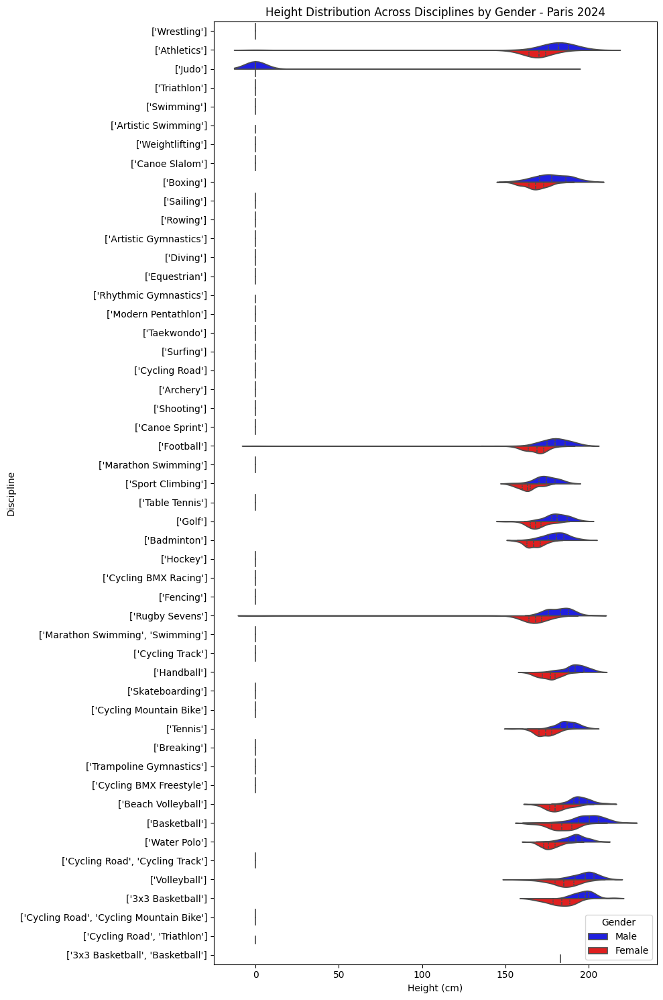

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Instead of loading from a file, use the existing 'athletes' DataFrame
# athletes = pd.read_csv('path_to_athletes_dataset.csv')

# Filter relevant data
height_data = athletes.dropna(subset=['height', 'gender', 'disciplines']) # discipline column is renamed to disciplines

# Plot
plt.figure(figsize=(10, 15))
sns.violinplot(
    data=height_data,
    x='height',
    y='disciplines', # discipline column is renamed to disciplines
    hue='gender',
    split=True,
    scale='width',
    inner='quartile',
    palette={'Male': 'blue', 'Female': 'red'}
)

plt.title("Height Distribution Across Disciplines by Gender - Paris 2024")
plt.xlabel("Height (cm)")
plt.ylabel("Discipline")
plt.legend(title="Gender", loc="lower right")
plt.tight_layout()
plt.show()

<ipython-input-112-4875558325a8>:6: FutureWarning:



The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.



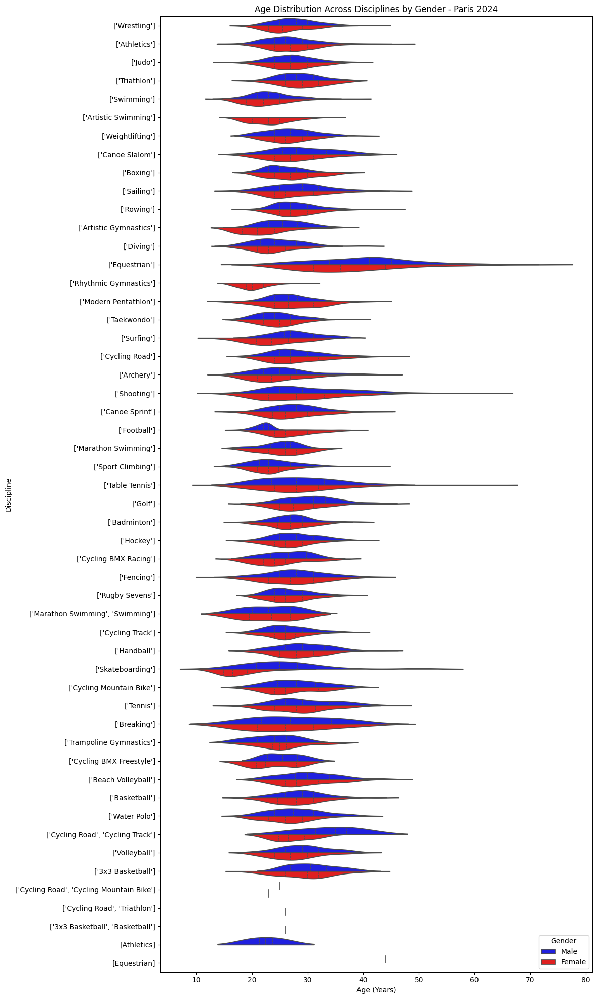

In [ ]:
# Filter data for age distribution
age_data = athletes.dropna(subset=['age', 'gender', 'disciplines'])  # Change 'discipline' to 'disciplines'

# Plot
plt.figure(figsize=(12, 20))
sns.violinplot(
    data=age_data,
    x='age',
    y='disciplines',  # Change 'discipline' to 'disciplines'
    hue='gender',
    split=True,
    scale='width',
    inner='quartile',
    palette={'Male': 'blue', 'Female': 'red'}
)

plt.title("Age Distribution Across Disciplines by Gender - Paris 2024")
plt.xlabel("Age (Years)")
plt.ylabel("Discipline")
plt.legend(title="Gender", loc="lower right")
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import plotly.express as px

# Instead of loading from a file, use the existing 'athletes' DataFrame
# athletes = pd.read_csv('path_to_athletes_dataset.csv')
# The 'athletes' DataFrame is already loaded, so we can use it directly.

# Filter relevant data
age_gender_data = athletes.dropna(subset=['age', 'gender'])

# Visualization
fig = px.histogram(
    age_gender_data,
    x='age',
    color='gender',
    nbins=30,
    title="Age Distribution by Gender",
    labels={'age': 'Age (Years)', 'count': 'Number of Athletes'},
    barmode='overlay'
)
fig.update_layout(xaxis_title="Age (Years)", yaxis_title="Number of Athletes")
fig.show()

In [ ]:
# Aggregate medal count by age and gender
medals_data = athletes.groupby(['age', 'gender']).size().reset_index(name='medal_count')

# Visualization
fig = px.line(
    medals_data,
    x='age',
    y='medal_count',
    color='gender',
    title="Age vs. Number of Medals by Gender",
    labels={'age': 'Age (Years)', 'medal_count': 'Number of Medals'}
)
fig.update_traces(mode='lines+markers')
fig.show()


In [ ]:
# Aggregate median age by discipline and gender
median_age_data = athletes.groupby(['disciplines', 'gender'])['age'].median().reset_index()

# Visualization
fig = px.bar(
    median_age_data,
    x='disciplines', # Changed 'discipline' to 'disciplines'
    y='age',
    color='gender',
    barmode='group',
    title="Median Age by Discipline and Gender",
    labels={'age': 'Median Age', 'discipline': 'Discipline'}
)
fig.update_layout(xaxis_tickangle=45)
fig.show()

In [ ]:
# Define age groups
athletes['age_group'] = pd.cut(athletes['age'], bins=[10, 20, 30, 40, 50, 60], labels=['10-20', '20-30', '30-40', '40-50', '50-60'])

# Count participation by age group and gender
age_group_data = athletes.groupby(['age_group', 'gender']).size().reset_index(name='count')

# Visualization
fig = px.bar(
    age_group_data,
    x='age_group',
    y='count',
    color='gender',
    barmode='group',
    title="Gender Participation Across Age Groups",
    labels={'age_group': 'Age Group', 'count': 'Number of Athletes'}
)
fig.show()


<ipython-input-118-e7a83ccf744e>:5: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [ ]:
import pandas as pd

# Load the uploaded datasets
selected_athletes_performance = pd.read_csv('/content/Selected athletes - Global performance.csv')
selected_athletes_sentiment = pd.read_csv('/content/Selected athletes - Sentiment over time .csv')
sports_engagement = pd.read_csv('//content/Sports - Engagement Actions.csv')
top_sports_conversations = pd.read_csv('//content/Top sports - Conversations over time .csv')
top_sports_sentiment = pd.read_csv('/content/Top sports - Sentiment over time .csv')

# Display basic information and a preview of each dataset
datasets = {
    "Top Sports Sentiment": top_sports_sentiment,
    "Top Sports Conversations": top_sports_conversations,
    "Sports Engagement Actions": sports_engagement,
    "Selected Athletes Sentiment": selected_athletes_sentiment,
    "Selected Athletes Performance": selected_athletes_performance,
}

dataset_info = {}

for name, df in datasets.items():
    dataset_info[name] = {
        "Shape": df.shape,
        "Columns": df.columns.tolist(),
        "Preview": df.head()
    }

import pandas as pd

display(pd.DataFrame(dataset_info))  # Use pandas display for Jupyter notebooks

# or print to console if not in Jupyter
# print(pd.DataFrame(dataset_info))

,Top Sports Sentiment,Top Sports Conversations,Sports Engagement Actions,Selected Athletes Sentiment,Selected Athletes Performance
Shape,"(44, 4)","(17, 45)","(44, 2)","(12, 4)","(12, 2)"
Columns,"[Olympics sports, Neutral, Positive, Negative]","[Date, Football, Basketball, Swimming, Tennis,...","[Olympics sports, Engagement Actions]",[12 of the biggest athletets to watch at Paris...,[12 of the biggest athletets to watch at Paris...
Preview,Olympics sports Neutral Positive Negative...,Date Football Basketball Swimming ...,Olympics sports Engagement Actions 0 B...,12 of the biggest athletets to watch at Pari...,12 of the biggest athletets to watch at Pari...


In [ ]:
# Adjusted visualizations with corrected column names

# Visualization 1: Sports Sentiment Analysis
fig1 = px.bar(
    top_sports_sentiment,
    x='Olympics sports',
    y=['Neutral', 'Positive', 'Negative'],
    title="Sentiment Distribution for Olympic Sports",
    labels={'value': 'Sentiment Count', 'variable': 'Sentiment Type', 'Olympics sports': 'Sport'},
    barmode='stack'
)
fig1.update_layout(height=600, xaxis_tickangle=45)
fig1.show()

# Visualization 2: Conversations Over Time
top_sports_conversations_melted = top_sports_conversations.melt(
    id_vars='Date',
    var_name='Sport',
    value_name='Conversations'
)

fig2 = px.line(
    top_sports_conversations_melted,
    x='Date',
    y='Conversations',
    color='Sport',
    title="Conversations About Sports Over Time",
    labels={'Date': 'Date', 'Conversations': 'Number of Conversations'},
)
fig2.update_layout(height=600)
fig2.show()

# Visualization 3: Engagement Actions
fig3 = px.bar(
    sports_engagement,
    x='Engagement Actions',
    y='Olympics sports',
    orientation='h',
    title="Engagement Actions for Olympic Sports",
    labels={'Engagement Actions': 'Number of Actions', 'Olympics sports': 'Sport'},
)
fig3.update_layout(height=600)
fig3.show()

# Visualization 4: Athletes Sentiment Analysis
fig4 = px.bar(
    selected_athletes_sentiment,
    x='12 of the biggest athletets to watch at Paris 2024',
    y=['Neutral', 'Positive', 'Negative'],
    title="Sentiment Distribution for Selected Athletes",
    labels={
        'value': 'Sentiment Count',
        'variable': 'Sentiment Type',
        '12 of the biggest athletets to watch at Paris 2024': 'Athlete'
    },
    barmode='stack'
)
fig4.update_layout(height=600, xaxis_tickangle=45)
fig4.show()

# Visualization 5: Global Performance of Athletes
fig5 = px.bar(
    selected_athletes_performance,
    x='12 of the biggest athletets to watch at Paris 2024',
    y='Posts',
    title="Global Performance of Selected Athletes",
    labels={
        'Posts': 'Performance Posts',
        '12 of the biggest athletets to watch at Paris 2024': 'Athlete'
    },
)
fig5.update_layout(height=600, xaxis_tickangle=45)
fig5.show()
